<a href="https://colab.research.google.com/github/JadeBenson/Wikipedia_DeepLearning/blob/main/Image_Models.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Image Models

## Jade Benson

In this notebook, we use various image modeling techniques to better understand how posters are related to their genres. Posters are cultural products used to market the movie and convey relevant information to their audience. 


There are two sections: 


1) Genre multilabel classification 

2) Poster clustering and comparison to genres 

### Genre multilabel classification

In [24]:
import pandas as pd 
import numpy as np 
from skimage.io import imshow, imsave, imread
from skimage.color import rgb2hsv
from PIL import Image
import random 
import requests
from collections import Counter
import matplotlib.pyplot as plt

In [4]:
#this is the cleaned dataset with movie summaries/info of ONLY movies with poster RGB arrays
#includes genres created from Egemen's code

movie_and_posters = pd.read_csv('/content/drive/MyDrive/Wiki_DL/movies_posters_genres.csv')
print(len(movie_and_posters)) #13,680

13680


In [5]:
movie_and_posters.head()

,Unnamed: 0,Unnamed: 0.1,wiki_ID,freebase_ID,title,date,revenue,runtime,language,country,...,match_title,plot,year,imdbId,Imdb Link,Title,IMDB Score,Genre,Poster,poster_indicator
0,0,0,975900,/m/03vyhn,Ghosts of Mars,2001-08-24,14010832.0,98.0,"{""/m/02h40lc"": ""English Language""}","{""/m/09c7w0"": ""United States of America""}",...,ghostsofmars,"Set in the second half of the 22nd century, th...",2001,228333,http://www.imdb.com/title/tt228333,Ghosts of Mars (2001),4.9,Action|Horror|Sci-Fi,https://images-na.ssl-images-amazon.com/images...,1.0
1,1,1,9363483,/m/0285_cd,White Of The Eye,1987,NaN,110.0,"{""/m/02h40lc"": ""English Language""}","{""/m/07ssc"": ""United Kingdom""}",...,whiteoftheeye,A series of murders of rich young women throug...,1987,94320,http://www.imdb.com/title/tt94320,White of the Eye (1987),6.4,Horror|Thriller,https://images-na.ssl-images-amazon.com/images...,1.0
2,2,2,6631279,/m/0gffwj,Little city,1997-04-04,NaN,93.0,"{""/m/02h40lc"": ""English Language""}","{""/m/09c7w0"": ""United States of America""}",...,littlecity,"Adam, a San Francisco-based artist who works a...",1997,119548,http://www.imdb.com/title/tt119548,Little City (1997),6.1,Comedy|Romance,https://images-na.ssl-images-amazon.com/images...,1.0
3,3,3,171005,/m/016ywb,Henry V,1989-11-08,10161099.0,137.0,"{""/m/02h40lc"": ""English Language""}","{""/m/07ssc"": ""United Kingdom""}",...,henryv,{{Plot|dateAct 1Act 2Act 3Act 4Act 5 Finally n...,1989,97499,http://www.imdb.com/title/tt97499,Henry V (1989),7.7,Action|Biography|Drama,https://images-na.ssl-images-amazon.com/images...,1.0
4,4,4,77856,/m/0kcn7,Mary Poppins,1964-08-27,102272727.0,139.0,"{""/m/02h40lc"": ""English Language""}","{""/m/09c7w0"": ""United States of America""}",...,marypoppins,The film opens with Mary Poppins perched in a...,1964,58331,http://www.imdb.com/title/tt58331,Mary Poppins (1964),7.8,Comedy|Family|Fantasy,https://images-na.ssl-images-amazon.com/images...,1.0


In [6]:
wiki = movie_and_posters[~movie_and_posters['Genre'].isna()]

wiki['Genre'] = wiki['Genre'].apply(lambda x: x.split('|'))

genres = wiki['Genre'].sum()

genres = Counter(genres)
genres = [k for k, v in genres.items() if v > 900] + ['Western']
genres = dict(zip(genres, range(len(genres))))



In [8]:
genres


{'Action': 0,
 'Adventure': 7,
 'Comedy': 3,
 'Crime': 8,
 'Drama': 5,
 'Family': 6,
 'Horror': 1,
 'Mystery': 9,
 'Romance': 4,
 'Thriller': 2,
 'Western': 10}

In [7]:
one_hot_genres = []
for genre_list in wiki['Genre']: 
    one_hot_genre = np.zeros(len(genres))
    for genre in genre_list: 
        try:
            one_hot_genre[genres[genre]] = 1
        except KeyError: 
            continue
    one_hot_genres.append(one_hot_genre)

one_hot_genres = np.array(one_hot_genres)


In [22]:
len(one_hot_genres)
#13,680 posters with genres, multiple genres allowed per one movie

13680

In [9]:
one_hot_genres

array([[1., 1., 0., ..., 0., 0., 0.],
       [0., 1., 1., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [1., 0., 0., ..., 0., 0., 0.],
       [0., 1., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]])

In [16]:
#simple way to multihot encode directly into the dataframe 

wiki['Action'] = wiki['Genre'].apply(lambda x: 1 if 'Action' in x else 0)
wiki['Adventure'] = wiki['Genre'].apply(lambda x: 1 if 'Adventure' in x else 0)
wiki['Comedy'] = wiki['Genre'].apply(lambda x: 1 if 'Comedy' in x else 0)
wiki['Crime'] = wiki['Genre'].apply(lambda x: 1 if 'Crime' in x else 0)
wiki['Drama'] = wiki['Genre'].apply(lambda x: 1 if 'Drama' in x else 0)
wiki['Family'] = wiki['Genre'].apply(lambda x: 1 if 'Family' in x else 0)
wiki['Horror'] = wiki['Genre'].apply(lambda x: 1 if 'Horror' in x else 0)
wiki['Mystery'] = wiki['Genre'].apply(lambda x: 1 if 'Mystery' in x else 0)
wiki['Romance'] = wiki['Genre'].apply(lambda x: 1 if 'Romance' in x else 0)
wiki['Thriller'] = wiki['Genre'].apply(lambda x: 1 if 'Thriller' in x else 0)
wiki['Western'] = wiki['Genre'].apply(lambda x: 1 if 'Western' in x else 0)

In [17]:
wiki.head()

,Unnamed: 0,Unnamed: 0.1,wiki_ID,freebase_ID,title,date,revenue,runtime,language,country,...,Adventure,Comedy,Crime,Drama,Family,Horror,Mystery,Romance,Thriller,Western
0,0,0,975900,/m/03vyhn,Ghosts of Mars,2001-08-24,14010832.0,98.0,"{""/m/02h40lc"": ""English Language""}","{""/m/09c7w0"": ""United States of America""}",...,0,0,0,0,0,1,0,0,0,0
1,1,1,9363483,/m/0285_cd,White Of The Eye,1987,NaN,110.0,"{""/m/02h40lc"": ""English Language""}","{""/m/07ssc"": ""United Kingdom""}",...,0,0,0,0,0,1,0,0,1,0
2,2,2,6631279,/m/0gffwj,Little city,1997-04-04,NaN,93.0,"{""/m/02h40lc"": ""English Language""}","{""/m/09c7w0"": ""United States of America""}",...,0,1,0,0,0,0,0,1,0,0
3,3,3,171005,/m/016ywb,Henry V,1989-11-08,10161099.0,137.0,"{""/m/02h40lc"": ""English Language""}","{""/m/07ssc"": ""United Kingdom""}",...,0,0,0,1,0,0,0,0,0,0
4,4,4,77856,/m/0kcn7,Mary Poppins,1964-08-27,102272727.0,139.0,"{""/m/02h40lc"": ""English Language""}","{""/m/09c7w0"": ""United States of America""}",...,0,1,0,0,1,0,0,0,0,0


### Exploratory Analysis

In [ ]:
genre_list = ['Action', 'Horror', 'Thriller', 'Comedy', 'Romance', 'Drama', 'Family', 'Adventure', 'Crime', 'Mystery', 'Western']

In [127]:
genre_mat = wiki[genre_list]

In [131]:
genre_mat = genre_mat.astype(int)
co_occur_mat = genre_mat.T.dot(genre_mat)
co_occur_mat

,Action,Horror,Thriller,Comedy,Romance,Drama,Family,Adventure,Crime,Mystery,Western
Action,2203,159,375,477,95,745,60,701,668,54,25
Horror,159,1592,452,232,42,281,4,61,109,290,5
Thriller,375,452,1799,104,88,749,2,84,484,313,11
Comedy,477,232,104,5017,1269,1725,493,546,597,121,55
Romance,95,42,88,1269,2657,1732,55,110,131,75,69
Drama,745,281,749,1725,1732,7229,256,463,1411,470,93
Family,60,4,2,493,55,256,937,296,14,3,15
Adventure,701,61,84,546,110,463,296,1732,97,26,38
Crime,668,109,484,597,131,1411,14,97,2309,302,9
Mystery,54,290,313,121,75,470,3,26,302,988,3


In [133]:
upper_mat = np.triu(co_occur_mat)
upper_mat

array([[2203,  159,  375,  477,   95,  745,   60,  701,  668,   54,   25],
       [   0, 1592,  452,  232,   42,  281,    4,   61,  109,  290,    5],
       [   0,    0, 1799,  104,   88,  749,    2,   84,  484,  313,   11],
       [   0,    0,    0, 5017, 1269, 1725,  493,  546,  597,  121,   55],
       [   0,    0,    0,    0, 2657, 1732,   55,  110,  131,   75,   69],
       [   0,    0,    0,    0,    0, 7229,  256,  463, 1411,  470,   93],
       [   0,    0,    0,    0,    0,    0,  937,  296,   14,    3,   15],
       [   0,    0,    0,    0,    0,    0,    0, 1732,   97,   26,   38],
       [   0,    0,    0,    0,    0,    0,    0,    0, 2309,  302,    9],
       [   0,    0,    0,    0,    0,    0,    0,    0,    0,  988,    3],
       [   0,    0,    0,    0,    0,    0,    0,    0,    0,    0,  348]])

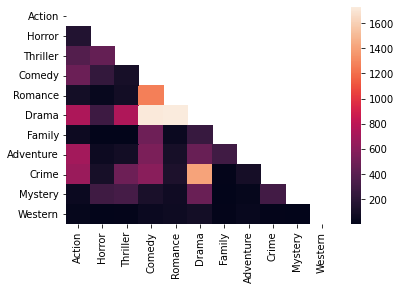

In [135]:
#co-occurence of genre labels heatmap 
import seaborn as sns 
sns.heatmap(co_occur_mat, mask=upper_mat);
#this makes a lot of sense!

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: FutureWarning: Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.
  This is separate from the ipykernel package so we can avoid doing imports until


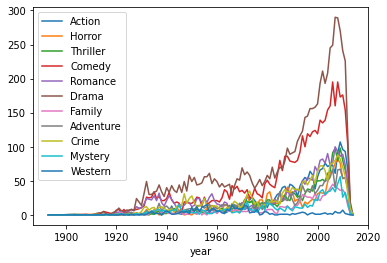

In [37]:
#How do the number and types of genres change over time? 

wiki.groupby(['year'])['Action', 'Horror', 'Thriller', 'Comedy', 'Romance', 'Drama', 'Family', 'Adventure', 'Crime', 'Mystery', 'Western'].agg('sum').plot(legend=True)

In [55]:
#How do the number and types of genres change over time? 

year_df = wiki.groupby(['year'])[genre_list].agg('sum').reset_index()


In [56]:
year_df['total_movies'] = year_df[genre_list].sum(axis=1)

In [57]:
year_df.describe()
#1893 - 2014 
#Drama is most popular genre (66.3 movies/year)
#Comedy is the second most popular genre (46 average movies/year)


,year,Action,Horror,Thriller,Comedy,Romance,Drama,Family,Adventure,Crime,Mystery,Western,total_movies
count,109.000000,109.000000,109.000000,109.000000,109.000000,109.000000,109.000000,109.000000,109.000000,109.000000,109.00000,109.000000,109.000000
mean,1959.660550,20.211009,14.605505,16.504587,46.027523,24.376147,66.321101,8.596330,15.889908,21.183486,9.06422,3.192661,245.972477
std,32.219795,26.074705,17.936110,22.532949,50.335993,24.449793,69.566233,11.240732,16.511129,22.228262,10.92167,3.760115,264.332824
min,1893.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000
25%,1933.000000,2.000000,1.000000,2.000000,11.000000,9.000000,27.000000,1.000000,3.000000,6.000000,2.00000,0.000000,80.000000
50%,1960.000000,8.000000,8.000000,7.000000,25.000000,17.000000,46.000000,5.000000,11.000000,13.000000,6.00000,2.000000,152.000000
75%,1987.000000,30.000000,21.000000,21.000000,65.000000,28.000000,70.000000,9.000000,20.000000,32.000000,10.00000,5.000000,315.000000
max,2014.000000,107.000000,82.000000,98.000000,195.000000,100.000000,290.000000,45.000000,67.000000,88.000000,56.00000,15.000000,1071.000000


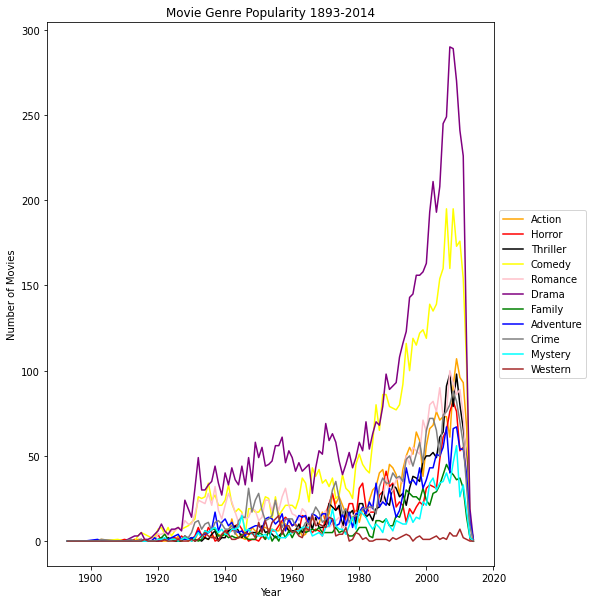

In [58]:
#plot number of movies per year

fig, ax = plt.subplots(figsize=(10,10 ))
  
# setting title to graph
ax.set_title('Movie Genre Popularity 1893-2014')
  
# label x-axis and y-axis
ax.set_ylabel('Number of Movies')
ax.set_xlabel('Year')
  
ax.plot(year_df['year'], year_df['Action'], label = "Action", color = 'orange')
ax.plot(year_df['year'], year_df['Horror'], label = "Horror", color = 'red')
ax.plot(year_df['year'], year_df['Thriller'], label = "Thriller", color = 'black')
ax.plot(year_df['year'], year_df['Comedy'], label = "Comedy", color = 'yellow')
ax.plot(year_df['year'], year_df['Romance'], label = "Romance", color = 'pink')
ax.plot(year_df['year'], year_df['Drama'], label = "Drama", color = 'purple')
ax.plot(year_df['year'], year_df['Family'], label = "Family", color = 'green')
ax.plot(year_df['year'], year_df['Adventure'], label = "Adventure", color = 'blue')
ax.plot(year_df['year'], year_df['Crime'], label = "Crime", color = 'grey')
ax.plot(year_df['year'], year_df['Mystery'], label = "Mystery", color = 'cyan')
ax.plot(year_df['year'], year_df['Western'], label = "Western", color = 'brown')


# Shrink current axis by 20%
box = ax.get_position()
ax.set_position([box.x0, box.y0, box.width * 0.8, box.height])

# Put a legend to the right of the current axis
ax.legend(loc='center left', bbox_to_anchor=(1, 0.5));



In [59]:
#proportions since it's a little hard to see the differences between smaller categories
year_df.iloc[:,1:] = year_df.iloc[:,1:].div(year_df.total_movies, axis=0)

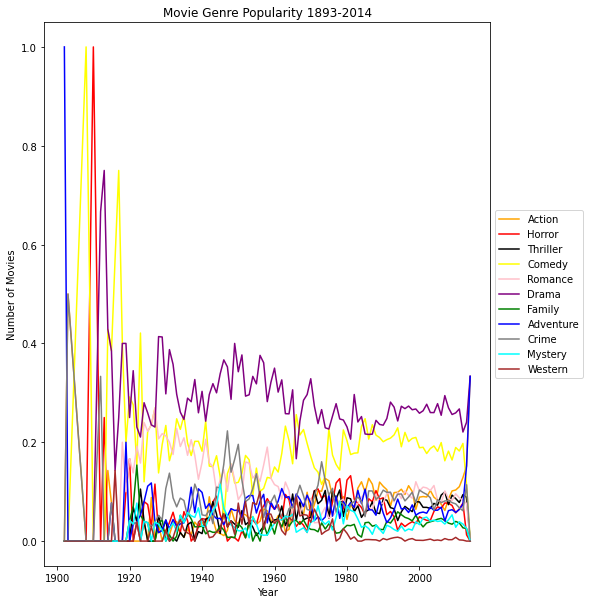

In [60]:
 #plot number of movies per year

fig, ax = plt.subplots(figsize=(10,10 ))
  
# setting title to graph
ax.set_title('Movie Genre Popularity 1893-2014')
  
# label x-axis and y-axis
ax.set_ylabel('Number of Movies')
ax.set_xlabel('Year')
  
ax.plot(year_df['year'], year_df['Action'], label = "Action", color = 'orange')
ax.plot(year_df['year'], year_df['Horror'], label = "Horror", color = 'red')
ax.plot(year_df['year'], year_df['Thriller'], label = "Thriller", color = 'black')
ax.plot(year_df['year'], year_df['Comedy'], label = "Comedy", color = 'yellow')
ax.plot(year_df['year'], year_df['Romance'], label = "Romance", color = 'pink')
ax.plot(year_df['year'], year_df['Drama'], label = "Drama", color = 'purple')
ax.plot(year_df['year'], year_df['Family'], label = "Family", color = 'green')
ax.plot(year_df['year'], year_df['Adventure'], label = "Adventure", color = 'blue')
ax.plot(year_df['year'], year_df['Crime'], label = "Crime", color = 'grey')
ax.plot(year_df['year'], year_df['Mystery'], label = "Mystery", color = 'cyan')
ax.plot(year_df['year'], year_df['Western'], label = "Western", color = 'brown')


# Shrink current axis by 20%
box = ax.get_position()
ax.set_position([box.x0, box.y0, box.width * 0.8, box.height])

# Put a legend to the right of the current axis
ax.legend(loc='center left', bbox_to_anchor=(1, 0.5));



#### Posters

In [61]:
#load in array of posters 
#this has already been cleaned locally to match the above dataframe
formatted_poster_genres = np.load('/content/drive/MyDrive/Wiki_DL/formatted_posters_genres.npy', allow_pickle = True)

In [62]:
formatted_poster_genres.shape

(13680, 268, 182, 3)

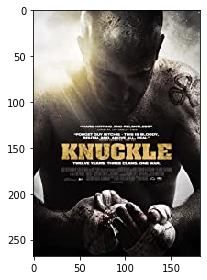

In [79]:
#just a double check
from skimage.io import imshow, imsave, imread
imshow(formatted_poster_genres[13679])

In [80]:
wiki.iloc[13679, :]

Unnamed: 0                                                      15388
Unnamed: 0.1                                                    15731
wiki_ID                                                      34980460
freebase_ID                                                /m/0g4pl34
title                                                         Knuckle
date                                                       2011-01-21
revenue                                                           NaN
runtime                                                          96.0
language                           {"/m/02h40lc": "English Language"}
country             {"/m/03rt9": "Ireland", "/m/07ssc": "United Ki...
genres              {"/m/03bxz7": "Biographical film", "/m/07s9rl0...
match_title                                                   knuckle
plot                {{No plot}} This film follows 12 years in the ...
year                                                             2011
imdbId              

### Classificiation

In [68]:
import keras
from keras import layers
from keras.models import Sequential
from keras.layers import Dense, Dropout, Flatten
from keras.layers import Conv2D, MaxPooling2D
from keras.preprocessing import image
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from tqdm import tqdm
%matplotlib inline

In [64]:
train_x, test_x, train_y, test_y = train_test_split(formatted_poster_genres, one_hot_genres, test_size=0.20, random_state=42)

In [65]:
train_x = train_x.astype("float32") / 255.0
#train_y = np.squeeze(train_y)
test_x = test_x.astype("float32") / 255.0
#test_y = np.squeeze(test_y)


In [66]:
print(train_x.shape)
print(test_x.shape)
print(train_y.shape)
print(test_y.shape)

(10944, 268, 182, 3)
(2736, 268, 182, 3)
(10944, 11)
(2736, 11)


In [69]:
num_classes = 11
input_shape = (268, 182, 3)

model = keras.Sequential(
    [
        keras.Input(shape=input_shape),
        layers.Conv2D(32, kernel_size=(3, 3), activation="relu"),
        layers.MaxPooling2D(pool_size=(2, 2)),
        layers.Conv2D(64, kernel_size=(3, 3), activation="relu"),
        layers.MaxPooling2D(pool_size=(2, 2)),
        layers.Flatten(),
        layers.Dropout(0.5),
     #activation = sigmoid allows for multilabel classification
     #https://www.analyticsvidhya.com/blog/2019/04/build-first-multi-label-image-classification-model-python/
        layers.Dense(num_classes, activation="sigmoid"),
    ]
)
model.summary()



Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 266, 180, 32)      896       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 133, 90, 32)      0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 131, 88, 64)       18496     
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 65, 44, 64)       0         
 2D)                                                             
                                                                 
 flatten (Flatten)           (None, 183040)            0         
                                                                 
 dropout (Dropout)           (None, 183040)            0

In [72]:
#train

batch_size = 128
epochs = 10

model.compile(loss="binary_crossentropy", optimizer="adam", metrics=["accuracy", keras.metrics.AUC()])

model.fit(train_x, train_y, batch_size=batch_size, epochs=epochs, validation_split=0.1)



Epoch 1/10
77/77 [==============================] - 377s 5s/step - loss: 0.3158 - accuracy: 0.3887 - auc_1: 0.8742 - val_loss: 0.4269 - val_accuracy: 0.2411 - val_auc_1: 0.7504
Epoch 2/10
77/77 [==============================] - 360s 5s/step - loss: 0.2674 - accuracy: 0.4303 - auc_1: 0.9161 - val_loss: 0.4539 - val_accuracy: 0.2703 - val_auc_1: 0.7444
Epoch 3/10
77/77 [==============================] - 352s 5s/step - loss: 0.2188 - accuracy: 0.4768 - auc_1: 0.9468 - val_loss: 0.5048 - val_accuracy: 0.2329 - val_auc_1: 0.7307
Epoch 4/10
77/77 [==============================] - 355s 5s/step - loss: 0.1754 - accuracy: 0.4926 - auc_1: 0.9675 - val_loss: 0.5503 - val_accuracy: 0.2530 - val_auc_1: 0.7164
Epoch 5/10
77/77 [==============================] - 356s 5s/step - loss: 0.1382 - accuracy: 0.5222 - auc_1: 0.9804 - val_loss: 0.6164 - val_accuracy: 0.2438 - val_auc_1: 0.7123
Epoch 6/10
77/77 [==============================] - 353s 5s/step - loss: 0.1080 - accuracy: 0.5318 - auc_1: 0.9885 

In [81]:
#evaluate 
score = model.evaluate(test_x, test_y, verbose=0)
print("Test loss:", score[0])
print("Test accuracy:", score[1])
print("Test AUC:", score[2])
#the accuracy is pretty low but better than random 1/11 (0.09) would be random
# but the AUC is not bad

Test loss: 0.9504315257072449
Test accuracy: 0.2569444477558136
Test AUC: 0.6989165544509888


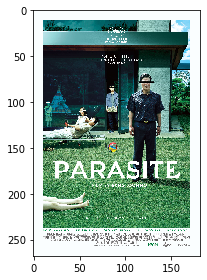

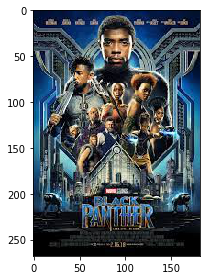

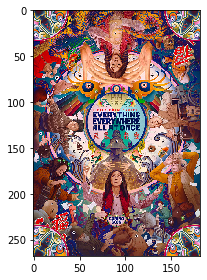

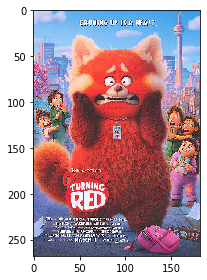

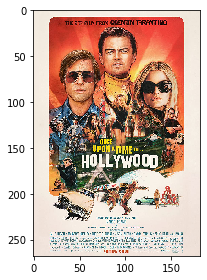

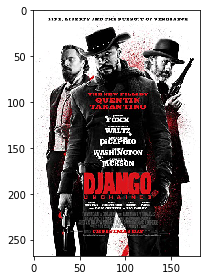

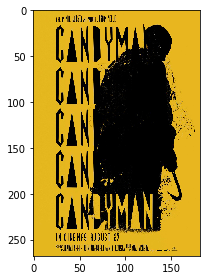

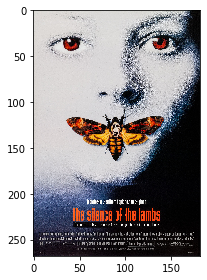

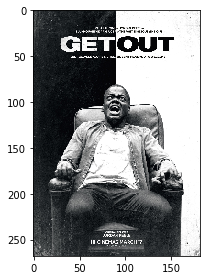

In [123]:
test_posters_links = ['/content/drive/MyDrive/Wiki_DL/parasite_poster.png', 
                      '/content/drive/MyDrive/Wiki_DL/black_panther_poster.png', 
                      '/content/drive/MyDrive/Wiki_DL/EEAO.png', 
                      '/content/drive/MyDrive/Wiki_DL/turning_red_poster.png', 
                      '/content/drive/MyDrive/Wiki_DL/once_upon_poster.png', 
                      '/content/drive/MyDrive/Wiki_DL/Django_poster.png', 
                      '/content/drive/MyDrive/Wiki_DL/candyman_poster.png', 
                      '/content/drive/MyDrive/Wiki_DL/silence_lambs.png',
                      '/content/drive/MyDrive/Wiki_DL/get_out_poster.png']

#put all the test posters in a list to get correct formatting later
test_posters = []
for l in test_posters_links: 
  poster = image.load_img(l,target_size=input_shape)
  poster_rbg = poster.convert('RGB')
  poster_array = np.array(poster_rbg)
  poster_array = poster_array.astype("float32") / 255.0
  imshow(poster_array)
  plt.show()
  test_posters.append(poster_array)

formatted_test_posters = np.concatenate([[x] for x in test_posters if x is not None], axis=0)



In [124]:
test_model_genres = model.predict(formatted_test_posters)

In [125]:
test_movie_names = ['Parasite', 
                    'Black Panther', 
                    'Everything Everywhere All at Once', 
                    'Turning Red', 
                    'Once Upon a Time in... Hollywood', 
                    'Django', 
                    'Candyman', 
                    'Silence of the Lambs', 
                    'Get Out']

In [126]:
for p in range(len(test_model_genres)): 
  top_3 = np.argsort(test_model_genres[p])[:-4:-1]
  print("Top 3 Predicted Genres for", test_movie_names[p], ":")

  for t in top_3: 
    for key, val in genres.items(): 
        if val == t:
            print(key)


Top 3 Predicted Genres for Parasite :
Drama
Comedy
Romance
Top 3 Predicted Genres for Black Panther :
Action
Adventure
Comedy
Top 3 Predicted Genres for Everything Everywhere All at Once :
Comedy
Adventure
Drama
Top 3 Predicted Genres for Turning Red :
Comedy
Family
Adventure
Top 3 Predicted Genres for Once Upon a Time in... Hollywood :
Drama
Adventure
Action
Top 3 Predicted Genres for Django :
Comedy
Drama
Romance
Top 3 Predicted Genres for Candyman :
Drama
Thriller
Crime
Top 3 Predicted Genres for Silence of the Lambs :
Drama
Crime
Adventure
Top 3 Predicted Genres for Get Out :
Adventure
Horror
Crime


### Clustering 


For clustering and near neighbors, we are going to use simpler labels derived from the poster genres. We impose a stricter restriction that posters can only belong to one genre. We will discuss the implications of this decision later. 


In [ ]:
#what happens if we just select first genre in genre list?     
wiki['first_genre_cluster'] = wiki['Genre'].apply(lambda x: x[0])

In [ ]:
wiki.head()

,Unnamed: 0,Unnamed: 0.1,wiki_ID,freebase_ID,title,date,revenue,runtime,language,country,...,plot,year,imdbId,Imdb Link,Title,IMDB Score,Genre,Poster,poster_indicator,first_genre_cluster
0,0,0,975900,/m/03vyhn,Ghosts of Mars,2001-08-24,14010832.0,98.0,"{""/m/02h40lc"": ""English Language""}","{""/m/09c7w0"": ""United States of America""}",...,"Set in the second half of the 22nd century, th...",2001,228333,http://www.imdb.com/title/tt228333,Ghosts of Mars (2001),4.9,"[Action, Horror, Sci-Fi]",https://images-na.ssl-images-amazon.com/images...,1.0,Action
1,1,1,9363483,/m/0285_cd,White Of The Eye,1987,NaN,110.0,"{""/m/02h40lc"": ""English Language""}","{""/m/07ssc"": ""United Kingdom""}",...,A series of murders of rich young women throug...,1987,94320,http://www.imdb.com/title/tt94320,White of the Eye (1987),6.4,"[Horror, Thriller]",https://images-na.ssl-images-amazon.com/images...,1.0,Horror
2,2,2,6631279,/m/0gffwj,Little city,1997-04-04,NaN,93.0,"{""/m/02h40lc"": ""English Language""}","{""/m/09c7w0"": ""United States of America""}",...,"Adam, a San Francisco-based artist who works a...",1997,119548,http://www.imdb.com/title/tt119548,Little City (1997),6.1,"[Comedy, Romance]",https://images-na.ssl-images-amazon.com/images...,1.0,Comedy
3,3,3,171005,/m/016ywb,Henry V,1989-11-08,10161099.0,137.0,"{""/m/02h40lc"": ""English Language""}","{""/m/07ssc"": ""United Kingdom""}",...,{{Plot|dateAct 1Act 2Act 3Act 4Act 5 Finally n...,1989,97499,http://www.imdb.com/title/tt97499,Henry V (1989),7.7,"[Action, Biography, Drama]",https://images-na.ssl-images-amazon.com/images...,1.0,Action
4,4,4,77856,/m/0kcn7,Mary Poppins,1964-08-27,102272727.0,139.0,"{""/m/02h40lc"": ""English Language""}","{""/m/09c7w0"": ""United States of America""}",...,The film opens with Mary Poppins perched in a...,1964,58331,http://www.imdb.com/title/tt58331,Mary Poppins (1964),7.8,"[Comedy, Family, Fantasy]",https://images-na.ssl-images-amazon.com/images...,1.0,Comedy


In [ ]:
sum(wiki['first_genre_cluster'].isnull())

0

In [ ]:
wiki['first_genre_cluster'].value_counts()

#maybe drop the smaller genres - anything under <80 

Comedy         3808
Drama          3129
Action         2035
Crime          1077
Horror          782
Adventure       769
Animation       548
Biography       491
Documentary     237
Western         115
Fantasy         111
Thriller         98
Mystery          89
Sci-Fi           81
Family           77
Short            69
Romance          61
Musical          56
War              28
History           7
Film-Noir         6
Music             5
Adult             1
Name: first_genre_cluster, dtype: int64

In [ ]:
drop_genre_list = ['Family', 'Short', 'Romance', 'Musical', 'War', 'History', 'Film-Noir', 'Music', 'Adult']

In [ ]:
def drop_genres(g): 
    if g in drop_genre_list:
      return None
    else:
      return 1 

wiki['genre_drop_indicator'] = wiki['first_genre_cluster'].apply(lambda x: drop_genres(x))
wiki.head()

,Unnamed: 0,Unnamed: 0.1,wiki_ID,freebase_ID,title,date,revenue,runtime,language,country,...,year,imdbId,Imdb Link,Title,IMDB Score,Genre,Poster,poster_indicator,first_genre_cluster,genre_drop_indicator
0,0,0,975900,/m/03vyhn,Ghosts of Mars,2001-08-24,14010832.0,98.0,"{""/m/02h40lc"": ""English Language""}","{""/m/09c7w0"": ""United States of America""}",...,2001,228333,http://www.imdb.com/title/tt228333,Ghosts of Mars (2001),4.9,"[Action, Horror, Sci-Fi]",https://images-na.ssl-images-amazon.com/images...,1.0,Action,1.0
1,1,1,9363483,/m/0285_cd,White Of The Eye,1987,NaN,110.0,"{""/m/02h40lc"": ""English Language""}","{""/m/07ssc"": ""United Kingdom""}",...,1987,94320,http://www.imdb.com/title/tt94320,White of the Eye (1987),6.4,"[Horror, Thriller]",https://images-na.ssl-images-amazon.com/images...,1.0,Horror,1.0
2,2,2,6631279,/m/0gffwj,Little city,1997-04-04,NaN,93.0,"{""/m/02h40lc"": ""English Language""}","{""/m/09c7w0"": ""United States of America""}",...,1997,119548,http://www.imdb.com/title/tt119548,Little City (1997),6.1,"[Comedy, Romance]",https://images-na.ssl-images-amazon.com/images...,1.0,Comedy,1.0
3,3,3,171005,/m/016ywb,Henry V,1989-11-08,10161099.0,137.0,"{""/m/02h40lc"": ""English Language""}","{""/m/07ssc"": ""United Kingdom""}",...,1989,97499,http://www.imdb.com/title/tt97499,Henry V (1989),7.7,"[Action, Biography, Drama]",https://images-na.ssl-images-amazon.com/images...,1.0,Action,1.0
4,4,4,77856,/m/0kcn7,Mary Poppins,1964-08-27,102272727.0,139.0,"{""/m/02h40lc"": ""English Language""}","{""/m/09c7w0"": ""United States of America""}",...,1964,58331,http://www.imdb.com/title/tt58331,Mary Poppins (1964),7.8,"[Comedy, Family, Fantasy]",https://images-na.ssl-images-amazon.com/images...,1.0,Comedy,1.0


In [ ]:
missing_genres = list(np.where(wiki['genre_drop_indicator'].isna())[0])
len(missing_genres)

310

In [ ]:
wiki_simple_genres = wiki.dropna(axis = 0, subset = ['genre_drop_indicator'])


In [ ]:
one_genre_posters = np.delete(formatted_poster_genres, missing_genres, axis=0)

In [ ]:
one_genre_posters.shape

(13370, 268, 182, 3)

In [ ]:
#create numerical values for the genres 

our_genres = {'Comedy' : 0,        
'Drama': 1,         
'Action': 2,    
'Crime' : 3,      
'Horror': 4,      
'Adventure': 5,       
'Animation' : 6,       
'Biography' : 7,    
'Documentary' : 8,    
'Western' : 9,  
'Fantasy' : 10,       
'Thriller' : 11,
'Mystery' : 12, 
'Sci-Fi' : 13} 


wiki_simple_genres['genre_number'] = wiki_simple_genres['first_genre_cluster'].apply(lambda x: our_genres[x])
wiki_simple_genres.head()

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


,Unnamed: 0,Unnamed: 0.1,wiki_ID,freebase_ID,title,date,revenue,runtime,language,country,...,imdbId,Imdb Link,Title,IMDB Score,Genre,Poster,poster_indicator,first_genre_cluster,genre_drop_indicator,genre_number
0,0,0,975900,/m/03vyhn,Ghosts of Mars,2001-08-24,14010832.0,98.0,"{""/m/02h40lc"": ""English Language""}","{""/m/09c7w0"": ""United States of America""}",...,228333,http://www.imdb.com/title/tt228333,Ghosts of Mars (2001),4.9,"[Action, Horror, Sci-Fi]",https://images-na.ssl-images-amazon.com/images...,1.0,Action,1.0,2
1,1,1,9363483,/m/0285_cd,White Of The Eye,1987,NaN,110.0,"{""/m/02h40lc"": ""English Language""}","{""/m/07ssc"": ""United Kingdom""}",...,94320,http://www.imdb.com/title/tt94320,White of the Eye (1987),6.4,"[Horror, Thriller]",https://images-na.ssl-images-amazon.com/images...,1.0,Horror,1.0,4
2,2,2,6631279,/m/0gffwj,Little city,1997-04-04,NaN,93.0,"{""/m/02h40lc"": ""English Language""}","{""/m/09c7w0"": ""United States of America""}",...,119548,http://www.imdb.com/title/tt119548,Little City (1997),6.1,"[Comedy, Romance]",https://images-na.ssl-images-amazon.com/images...,1.0,Comedy,1.0,0
3,3,3,171005,/m/016ywb,Henry V,1989-11-08,10161099.0,137.0,"{""/m/02h40lc"": ""English Language""}","{""/m/07ssc"": ""United Kingdom""}",...,97499,http://www.imdb.com/title/tt97499,Henry V (1989),7.7,"[Action, Biography, Drama]",https://images-na.ssl-images-amazon.com/images...,1.0,Action,1.0,2
4,4,4,77856,/m/0kcn7,Mary Poppins,1964-08-27,102272727.0,139.0,"{""/m/02h40lc"": ""English Language""}","{""/m/09c7w0"": ""United States of America""}",...,58331,http://www.imdb.com/title/tt58331,Mary Poppins (1964),7.8,"[Comedy, Family, Fantasy]",https://images-na.ssl-images-amazon.com/images...,1.0,Comedy,1.0,0


In [ ]:
y_array = wiki_simple_genres['genre_number'].to_numpy()
y_array

array([2, 4, 0, ..., 2, 0, 8])

In [ ]:
import sklearn 
from sklearn.model_selection import train_test_split

train_x, test_x, train_y, test_y = train_test_split(one_genre_posters, y_array, test_size=0.20, random_state=42)

In [ ]:
print(train_x.shape)
print(test_x.shape)
print(train_y.shape)
print(test_y.shape)

(10696, 268, 182, 3)
(2674, 268, 182, 3)
(10696,)
(2674,)


In [ ]:
np.sum(np.isnan(test_y))

0

In [ ]:
train_x = train_x.astype("float32") / 255.0
train_y = np.squeeze(train_y)
test_x = test_x.astype("float32") / 255.0
test_y = np.squeeze(test_y)


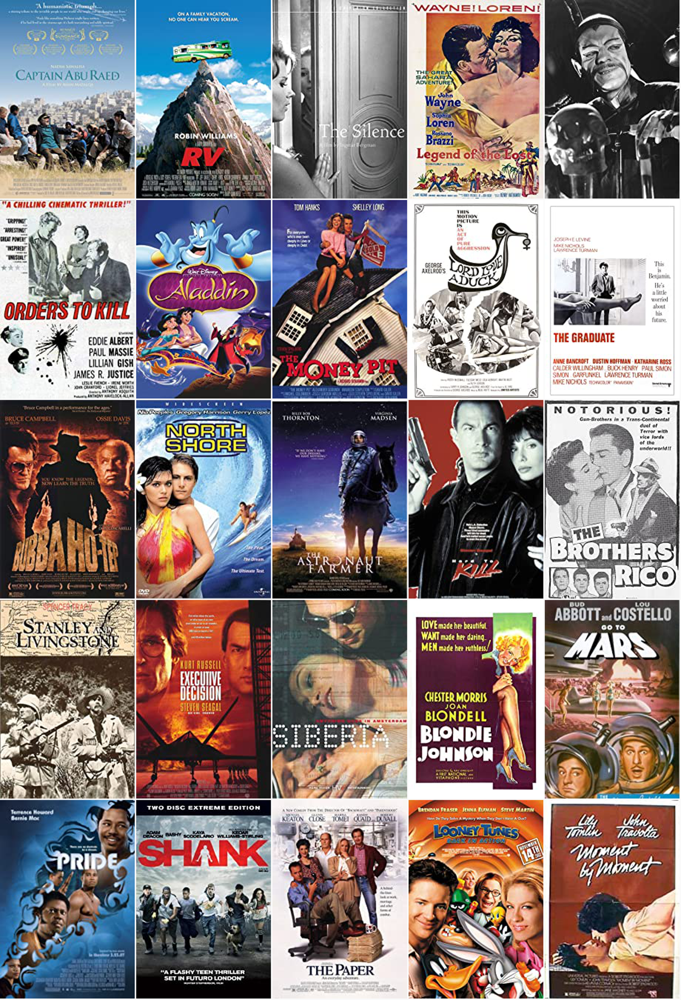

In [ ]:
height = 268
width = 182


def show_collage(examples):
    box_size = 32 + 2
    box_width = width + 2
    box_height = height + 2
    num_rows, num_cols = examples.shape[:2]

    collage = Image.new(
        mode="RGB",
        size=(num_cols * box_width, num_rows * box_height),
        color=(250, 250, 250),
    )
    for row_idx in range(num_rows):
        for col_idx in range(num_cols):
            array = (np.array(examples[row_idx, col_idx]) * 255).astype(np.uint8)
            collage.paste(
                Image.fromarray(array), (col_idx * box_width, row_idx * box_height)
            )
            

    # Double size for visualisation.
    collage = collage.resize((2 * num_cols * box_width, 2 * num_rows * box_height))
    return collage

# Show a collage of 5x5 random images.
sample_idxs = np.random.randint(0, 10944, size=(5, 5))
examples = train_x[sample_idxs]
show_collage(examples)



In [ ]:
import random
import matplotlib.pyplot as plt
import numpy as np
import tensorflow as tf
from collections import defaultdict
from PIL import Image
from sklearn.metrics import ConfusionMatrixDisplay
from tensorflow import keras
from tensorflow.keras import layers



In [ ]:
#want to group together images of the same genre 

class_idx_to_train_idxs = defaultdict(list)
for y_train_idx, i in enumerate(train_y):
    class_idx_to_train_idxs[i].append(y_train_idx)

class_idx_to_test_idxs = defaultdict(list)
for y_test_idx, j in enumerate(test_y):
    class_idx_to_test_idxs[j].append(y_test_idx)



In [ ]:
num_classes = 14


class AnchorPositivePairs(keras.utils.Sequence):
    def __init__(self, num_batchs):
        self.num_batchs = num_batchs

    def __len__(self):
        return self.num_batchs

    def __getitem__(self, _idx):
        x = np.empty((2, num_classes, height, width, 3), dtype=np.float32)
        for class_idx in range(num_classes):
            examples_for_class = class_idx_to_train_idxs[class_idx]
            anchor_idx = random.choice(examples_for_class)
            positive_idx = random.choice(examples_for_class)
            while positive_idx == anchor_idx:
                positive_idx = random.choice(examples_for_class)
            x[0, class_idx] = train_x[anchor_idx]
            x[1, class_idx] = train_x[positive_idx]

        return x



In [ ]:
examples = next(iter(AnchorPositivePairs(num_batchs=1)))


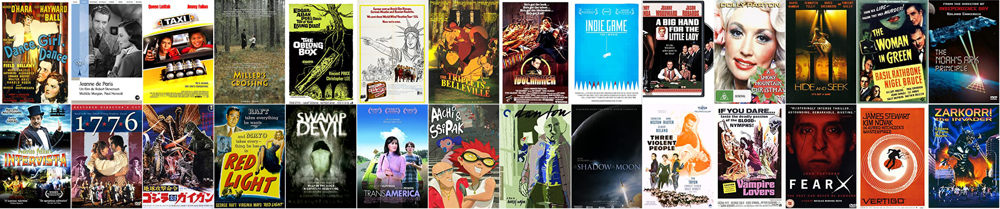

In [ ]:
show_collage(examples)


In [ ]:

class EmbeddingModel(keras.Model):
    def train_step(self, data):
        # Note: Workaround for open issue, to be removed.
        if isinstance(data, tuple):
            data = data[0]
        anchors, positives = data[0], data[1]

        with tf.GradientTape() as tape:
            # Run both anchors and positives through model.
            anchor_embeddings = self(anchors, training=True)
            positive_embeddings = self(positives, training=True)

            # Calculate cosine similarity between anchors and positives. As they have
            # been normalised this is just the pair wise dot products.
            similarities = tf.einsum(
                "ae,pe->ap", anchor_embeddings, positive_embeddings
            )

            # Since we intend to use these as logits we scale them by a temperature.
            # This value would normally be chosen as a hyper parameter.
            temperature = 0.2
            similarities /= temperature

            # We use these similarities as logits for a softmax. The labels for
            # this call are just the sequence [0, 1, 2, ..., num_classes] since we
            # want the main diagonal values, which correspond to the anchor/positive
            # pairs, to be high. This loss will move embeddings for the
            # anchor/positive pairs together and move all other pairs apart.
            sparse_labels = tf.range(num_classes)
            loss = self.compiled_loss(sparse_labels, similarities)

        # Calculate gradients and apply via optimizer.
        gradients = tape.gradient(loss, self.trainable_variables)
        self.optimizer.apply_gradients(zip(gradients, self.trainable_variables))

        # Update and return metrics (specifically the one for the loss value).
        self.compiled_metrics.update_state(sparse_labels, similarities)
        return {m.name: m.result() for m in self.metrics}



In [ ]:

inputs = layers.Input(shape=(height, width, 3))
x = layers.Conv2D(filters=32, kernel_size=3, strides=2, activation="relu")(inputs)
x = layers.Conv2D(filters=64, kernel_size=3, strides=2, activation="relu")(x)
x = layers.Conv2D(filters=128, kernel_size=3, strides=2, activation="relu")(x)
x = layers.GlobalAveragePooling2D()(x)
embeddings = layers.Dense(units=8, activation=None)(x)
embeddings = tf.nn.l2_normalize(embeddings, axis=-1)

model = EmbeddingModel(inputs, embeddings)



Epoch 1/5
50/50 [==============================] - 11s 206ms/step - loss: 2.6391
Epoch 2/5
50/50 [==============================] - 10s 204ms/step - loss: 2.6390
Epoch 3/5
50/50 [==============================] - 10s 205ms/step - loss: 2.6388
Epoch 4/5
50/50 [==============================] - 10s 204ms/step - loss: 2.6387
Epoch 5/5
50/50 [==============================] - 10s 206ms/step - loss: 2.6378


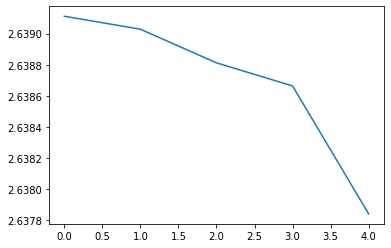

In [ ]:

model.compile(
    optimizer=keras.optimizers.Adam(learning_rate=1e-3),
    loss=keras.losses.SparseCategoricalCrossentropy(from_logits=True),
)

#lower number of batches and epochs so faster
#it's hard for this to run with so many samples even on Google Colab
history = model.fit(AnchorPositivePairs(num_batchs=50), epochs=5)

plt.plot(history.history["loss"])
plt.show()



In [ ]:
near_neighbours_per_example = 4

embeddings = model.predict(test_x)
gram_matrix = np.einsum("ae,be->ab", embeddings, embeddings)
near_neighbours = np.argsort(gram_matrix.T)[:, -(near_neighbours_per_example + 1) :]


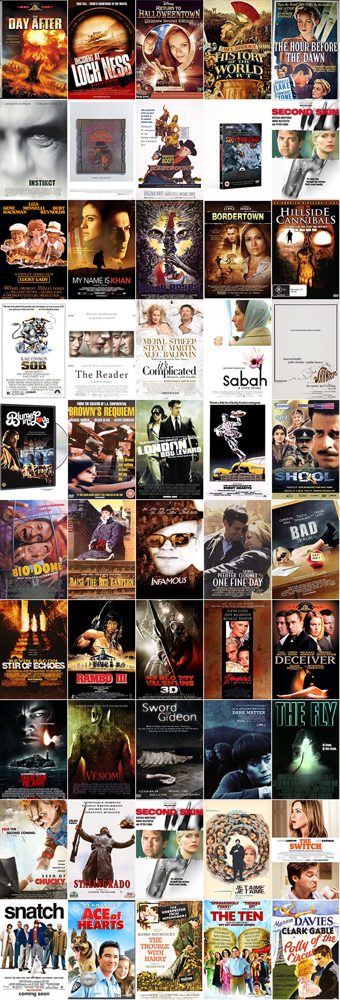

In [ ]:
num_collage_examples = 10

examples = np.empty(
    (
        num_collage_examples,
        near_neighbours_per_example + 1,
        height,
        width,
        3,
    ),
    dtype=np.float32,
)

genre_numbers = np.empty(
    (num_collage_examples,
        near_neighbours_per_example + 1), 
        dtype = np.int32,
)
     
for row_idx in range(num_collage_examples):
    examples[row_idx, 0] = test_x[row_idx]
    anchor_near_neighbours = reversed(near_neighbours[row_idx][:-1])
    for col_idx, nn_idx in enumerate(anchor_near_neighbours):
        examples[row_idx, col_idx + 1] = test_x[nn_idx]
        genre_numbers[row_idx, col_idx + 1] = test_y[nn_idx]

show_collage(examples)

#this is great! Motifs in poster design are being identified 
#however, these aren't very stratified by genre 

In [ ]:
genre_numbers
#I'm not sure what's happening with first value 
#I think this is because it's the anchor in the training set??? 

#bust as we can see, it doesn't really follow genres too clearly 

array([[1586447024,          5,          0,          0,          1],
       [     32547,          1,          9,          1,         11],
       [1585254640,          5,          4,          3,          0],
       [     32547,          1,          0,          0,          0],
       [1584636784,          3,          3,          0,          2],
       [     32547,          1,          7,          0,          0],
       [1584605680,          2,          4,          1,          3],
       [     32547,          4,          2,          1,          1],
       [1584047664,          1,         11,          1,          0],
       [     32547,          1,          0,          0,          0]],
      dtype=int32)

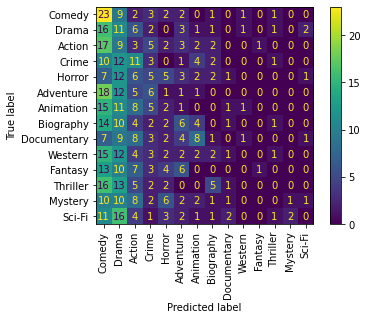

In [ ]:
confusion_matrix = np.zeros((num_classes, num_classes))

# For each class.
for class_idx in range(num_classes):
  #print(class_idx)
  # Consider 11 examples.
  example_idxs = class_idx_to_test_idxs[class_idx][:11]
  for y_test_idx in example_idxs:
    #print(y_test_idx)
    # And count the classes of its near neighbours.
    for nn_idx in near_neighbours[y_test_idx][:-1]:
      #print(nn_idx)
      nn_class_idx = test_y[nn_idx]
      #print(nn_class_idx)
      confusion_matrix[class_idx, int(nn_class_idx)] += 1


# Display a confusion matrix.
labels = ['Comedy',        
'Drama',         
'Action',    
'Crime',      
'Horror',      
'Adventure',       
'Animation',       
'Biography',    
'Documentary',    
'Western',  
'Fantasy',       
'Thriller',
'Mystery', 
'Sci-Fi'] 
    
disp = ConfusionMatrixDisplay(confusion_matrix=confusion_matrix, display_labels=labels)
disp.plot(include_values=True, cmap="viridis", ax=None, xticks_rotation="vertical")
plt.show()

#comedies are predicted well 
#this really shows that it relies on sample size, best when num posters / genre > 2000
